In [1]:
%matplotlib inline
from matplotlib import pyplot as plt

In [2]:
import datajoint as dj

In [3]:
schema = dj.schema('trasfer')

Please enter DataJoint username: root
Please enter DataJoint password: ········
Connecting root@localhost:3306


In [4]:
@schema
class Source(dj.Lookup):
    definition = """
    name : char(12)
    ---
    image_url : varchar(255)
    """
    
    contents = (
        ('mona', 'https://upload.wikimedia.org/wikipedia/commons/5/55/Mona_Lisa_headcrop.jpg'),
        ('starry', 'https://upload.wikimedia.org/wikipedia/commons/f/f2/VangoghStarry-night2.jpg'),
        ('eye', 'https://upload.wikimedia.org/wikipedia/commons/4/42/GreenEye3.jpg'),
        ('sunflower', 'https://upload.wikimedia.org/wikipedia/commons/e/e5/Sonnenblume_Helianthus_1.JPG'),
        ('roma', 'https://upload.wikimedia.org/wikipedia/commons/thumb/9/96/Foro_di_Cesare_a_Roma.jpg/1024px-Foro_di_Cesare_a_Roma.jpg')
    )

In [5]:
Source()

name,image_url
eye,https://upload.wikimedia.org/wikipedia/commons/4/42/GreenEye3.jpg
mona,https://upload.wikimedia.org/wikipedia/commons/5/55/Mona_Lisa_headcrop.jpg
roma,https://upload.wikimedia.org/wikipedia/commons/thumb/9/96/Foro_di_Cesare_a_Roma.jpg/1024px-Foro_di_Cesare_a_Roma.jpg
starry,https://upload.wikimedia.org/wikipedia/commons/f/f2/VangoghStarry-night2.jpg
sunflower,https://upload.wikimedia.org/wikipedia/commons/e/e5/Sonnenblume_Helianthus_1.JPG


In [6]:
import requests
import os

@schema
class Image(dj.Imported):
    definition = """
    -> Source
    ---
    image : longblob
    """
    
    def make(self, key):
        url = (Source & key).fetch1('image_url')
        tempfile = 'image.tmp'
        with open(tempfile, 'wb') as f:
            f.write(requests.get(url).content)
        self.insert1(dict(key, image=plt.imread(tempfile)))
        os.unlink(tempfile)

In [7]:
Image.populate(display_progress=True)

Image: 100%|██████████| 5/5 [00:07<00:00,  1.46s/it]


In [8]:
Image() * Source

name,image,image_url
eye,=BLOB=,https://upload.wikimedia.org/wikipedia/commons/4/42/GreenEye3.jpg
mona,=BLOB=,https://upload.wikimedia.org/wikipedia/commons/5/55/Mona_Lisa_headcrop.jpg
roma,=BLOB=,https://upload.wikimedia.org/wikipedia/commons/thumb/9/96/Foro_di_Cesare_a_Roma.jpg/1024px-Foro_di_Cesare_a_Roma.jpg
starry,=BLOB=,https://upload.wikimedia.org/wikipedia/commons/f/f2/VangoghStarry-night2.jpg
sunflower,=BLOB=,https://upload.wikimedia.org/wikipedia/commons/e/e5/Sonnenblume_Helianthus_1.JPG


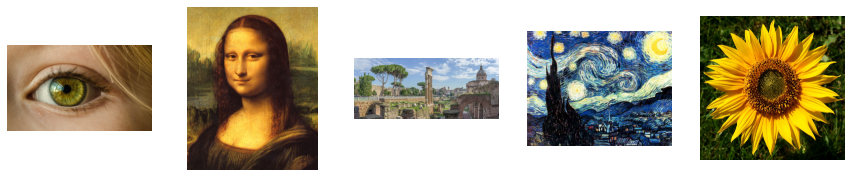

In [9]:
fig, ax = plt.subplots(1, len(Image()), figsize=(len(Image())*3,3))
for a, img in zip(ax, Image.fetch('image')):
    a.imshow(img)
    a.axis(False)

In [10]:
import numpy as np
import cv2
import imutils

In [11]:
@schema
class Crop(dj.Computed):
    definition = """
    -> Image
    ---
    cropped_image : longblob
    """
    
    def make(self, key):
        img = (Image & key).fetch1('image')
        sz = min((img.shape[:2]))
        sz1 = (img.shape[0] - sz)//2
        sz2 = (img.shape[1] - sz)//2
        img = imutils.resize(img[sz1:sz1+sz, sz2:sz2+sz], width=600, height=600)
        self.insert1(dict(key, cropped_image=img))

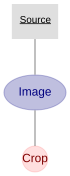

In [12]:
dj.Diagram(schema)

In [13]:
Crop.populate(display_progress=True)

Crop: 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]


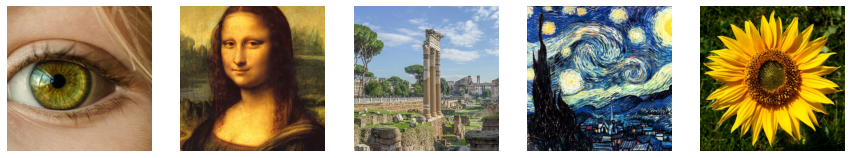

In [14]:
fig, ax = plt.subplots(1, len(Crop()), figsize=(len(Crop())*3,3))
for a, img in zip(ax, Crop.fetch('cropped_image')):
    a.imshow(img)
    a.axis(False)

In [15]:
@schema
class Style(dj.Lookup):
    definition = """
    style_name      : varchar(30)
    """
    contents = (['udnie'], ['la_muse'], ['starry_night'], ['mosaic'])

In [16]:
ls models

la_muse.t7  mosaic.t7  starry_night.t7  udnie.t7


In [17]:
image = Crop.fetch('cropped_image', limit=1)[0]

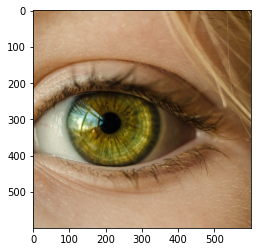

In [18]:
plt.imshow(image)

In [19]:
net = cv2.dnn.readNetFromTorch('/home/ubuntu/StyleTransfer/notebooks/models/la_muse.t7')    
image = imutils.resize(image, width=600)
(h, w) = image.shape[:2]

    # construct a blob from the image, set the input, and then perform a
    # forward pass of the network
blob = cv2.dnn.blobFromImage(image, 1.0, (w, h),
                                 (103.939, 116.779, 123.680), swapRB=False, crop=False)
net.setInput(blob)
output = net.forward()

    # reshape the output tensor, add back in the mean subtraction, and
    # then swap the channel ordering
output = output.reshape((3, output.shape[2], output.shape[3]))
output[0] += 103.939
output[1] += 116.779
output[2] += 123.680
output = output.transpose(1, 2, 0)
output = np.clip(output, 0, 255)
output= output.astype('uint8')

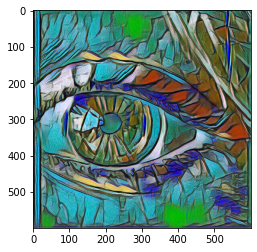

In [20]:
plt.imshow(output)

In [26]:
@schema
class Transfer(dj.Computed):
    definition = """
    -> Image
    -> Style
    ---
    art_image : longblob
    """
    
    def make(self, key):
        image = (Image & key).fetch1('image')
        style_name = (Style & key).fetch1('style_name')
        net = cv2.dnn.readNetFromTorch(f'/home/ubuntu/StyleTransfer/notebooks/models/{style_name}.t7')
        image = imutils.resize(image, width=800)
        (h, w) = image.shape[:2]

        # construct a blob from the image, set the input, and then perform a
        # forward pass of the network
        blob = cv2.dnn.blobFromImage(image, 1.0, (w, h),
                                     (103.939, 116.779, 123.680), swapRB=False, crop=False)
        net.setInput(blob)
        output = net.forward()

        # reshape the output tensor, add back in the mean subtraction, and
        # then swap the channel ordering
        output = output.reshape((3, output.shape[2], output.shape[3]))
        output[0] += 103.939
        output[1] += 116.779
        output[2] += 123.680
        output = output.transpose(1, 2, 0)
        output = np.clip(output, 0, 255)
        output= output.astype('uint8')
        self.insert1(dict(key, art_image=output))
        

In [27]:
Transfer.populate(display_progress=True)

Transfer: 100%|██████████| 20/20 [00:37<00:00,  1.85s/it]


In [28]:
Transfer()

name,style_name,art_image
eye,la_muse,=BLOB=
mona,la_muse,=BLOB=
roma,la_muse,=BLOB=
starry,la_muse,=BLOB=
sunflower,la_muse,=BLOB=
eye,mosaic,=BLOB=
mona,mosaic,=BLOB=
roma,mosaic,=BLOB=
starry,mosaic,=BLOB=
sunflower,mosaic,=BLOB=


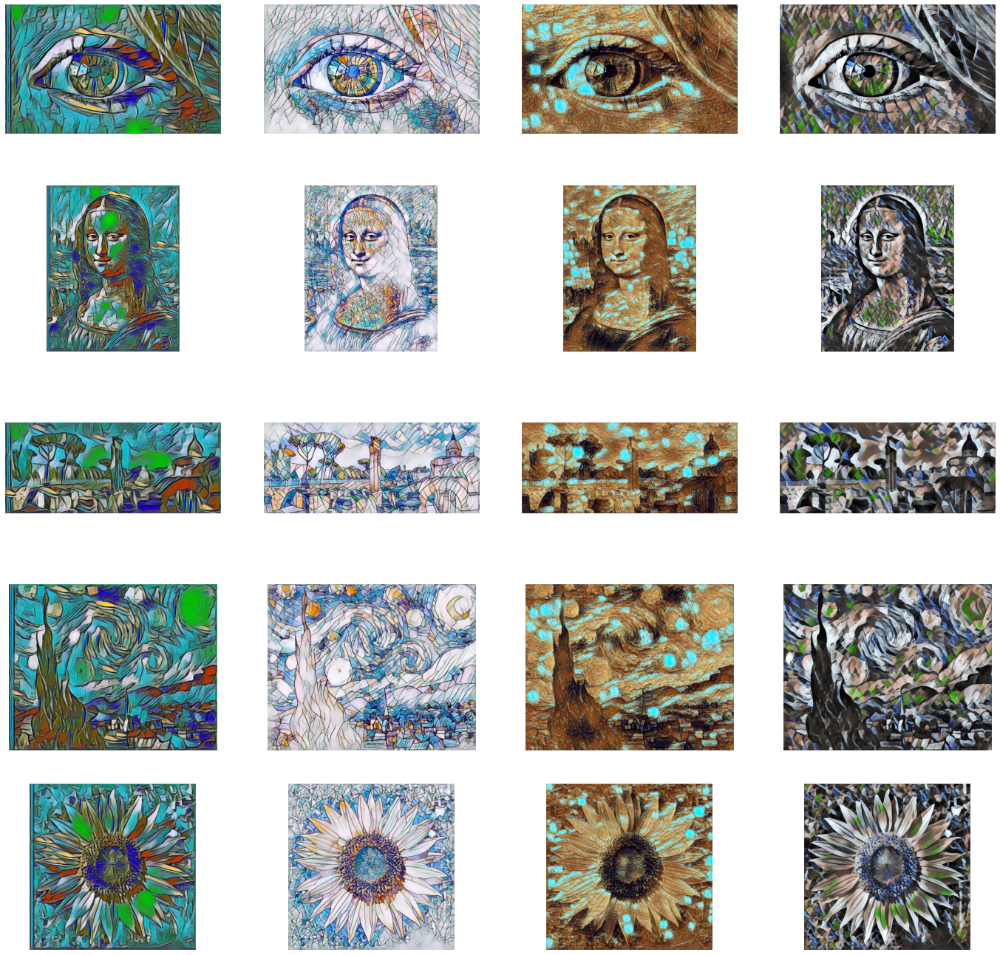

In [29]:
fig, axx = plt.subplots(5, 4, figsize=(24, 24))

for ax, img in zip(axx.flatten(), Transfer.fetch('art_image')):
    ax.imshow(img)
    ax.axis(False)

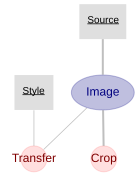

In [30]:
dj.Diagram(schema)

In [31]:
Image.populate(display_progress=True)
Transfer.populate(display_progress=True)

Image: 0it [00:00, ?it/s]
Transfer: 0it [00:00, ?it/s]


# Assignment

In [32]:
# Import Packages
import matplotlib.pyplot as plt
import argparse
import time
import imutils

In [33]:
def plt_imshow(title, image):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    plt.title(title)
    plt.grid(False)
    plt.show()

In [50]:
args = {
    "model" : "models/la_muse.t7",
    "image" : "images/Dog (1).jpeg"
}

In [51]:

# load the neural style
net = cv2.dnn.readNetFromTorch(args["model"])

# loading and resizing image
image = cv2.imread(args["image"])
image = imutils.resize(image, width = 600)
(h,w) = image.shape[:2]

# construct the blob from the image, set the input, and the perform a forward pass of the network
blob = cv2.dnn.blobFromImage(image, 1.0, (w,h),
                             (103.939, 116.779, 123.680), swapRB = False, crop = False)
net.setInput(blob)
start = time.time()
output = net.forward()
end = time.time()

[INFO] loading style transfer model...


In [52]:
output = output.reshape((3, output.shape[2], output.shape[3]))
output[0] += 103.939
output[1] += 116.779
output[2] += 123.680
output /= 255.0
output = output.transpose(1,2,0)

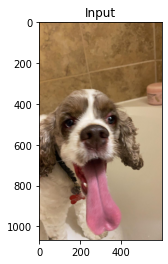

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


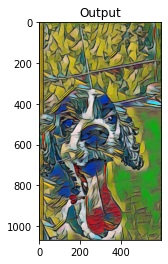

In [53]:
plt_imshow("Input", image)
plt_imshow("Output", output)

In [95]:
@schema

class Dog_Source(dj.Lookup):
    definition = """
    name : char(12)
    ---
    image_path : varchar(225)
    """
    contents = (
        ('dog1', 'images/Dog (1).jpeg'),
        ('dog2', 'images/Dog (2).jpeg'),
        ('dog3', 'images/Dog (3).jpeg'),
        ('dog4', 'images/Dog (4).jpeg'),
        ('dog5', 'images/Dog (5).jpeg'),
        ('dog6', 'images/Dog (6).jpeg'),
        ('dog7', 'images/Dog (7).jpeg')
    )

In [92]:
Dog_Source.drop()

`trasfer`.`#h_w__source` (7 tuples)
`trasfer`.`_h_w__image` (7 tuples)
Proceed? [yes, No]: yes
Tables dropped.  Restart kernel.


In [96]:
Dog_Source()

name,image_path
dog1,images/Dog (1).jpeg
dog2,images/Dog (2).jpeg
dog3,images/Dog (3).jpeg
dog4,images/Dog (4).jpeg
dog5,images/Dog (5).jpeg
dog6,images/Dog (6).jpeg
dog7,images/Dog (7).jpeg


In [115]:
@ schema
class Dog_Image(dj.Imported):
    definition = """
    -> Dog_Source
    
    ---
    
    image : longblob
    """
    
    def make(self, key):
        path = (Dog_Source & key).fetch1('image_path')
        img1 = cv2.imread(path)
        b,g,r = cv2.split(img1)
        rgb_img1 = cv2.merge([r,g,b])
        self.insert1(dict(key, image=rgb_img1))

In [99]:
Dog_Image.drop()

`trasfer`.`_dog__image` (0 tuples)
Proceed? [yes, No]: yes
Tables dropped.  Restart kernel.


In [116]:
Dog_Image.populate(display_progress = True)

Dog_Image: 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]


In [102]:
Dog_Image() * Dog_Source

name,image,image_path
dog1,=BLOB=,images/Dog (1).jpeg
dog2,=BLOB=,images/Dog (2).jpeg
dog3,=BLOB=,images/Dog (3).jpeg
dog4,=BLOB=,images/Dog (4).jpeg
dog5,=BLOB=,images/Dog (5).jpeg
dog6,=BLOB=,images/Dog (6).jpeg
dog7,=BLOB=,images/Dog (7).jpeg


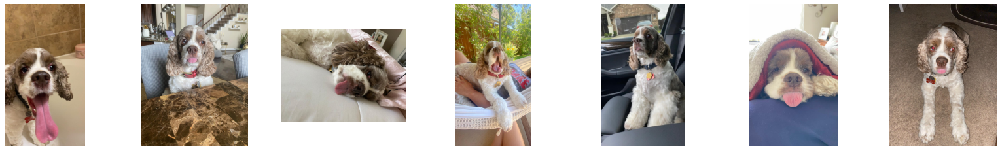

In [103]:
fig, ax = plt.subplots(1, len(Dog_Image()), figsize = (len(Dog_Image())*4,4))
for a, img in zip(ax, Dog_Image.fetch('image')):
    a.imshow(img)
    a.axis(False)

In [107]:
@schema
class Dog_Crop(dj.Computed):
    definition = """
    
    -> Dog_Image
    ---
    cropped_image : longblob
    """
    
    def make(self, key):
        img = (Dog_Image & key).fetch1('image')
        sz = min((img.shape[:2]))
        sz1 = (img.shape[0] - sz)//2
        sz2 = (img.shape[1] - sz)//2
        img = imutils.resize(img[sz1:sz1+sz, sz2:sz2+sz], width=600, height=600)
        self.insert1(dict(key, cropped_image=img))

In [106]:
Dog_Crop.drop()

`trasfer`.`__dog__crop` (0 tuples)
Proceed? [yes, No]: yes
Tables dropped.  Restart kernel.


In [108]:
Dog_Crop.populate(display_progress = True)

Dog_Crop: 100%|██████████| 7/7 [00:01<00:00,  3.61it/s]


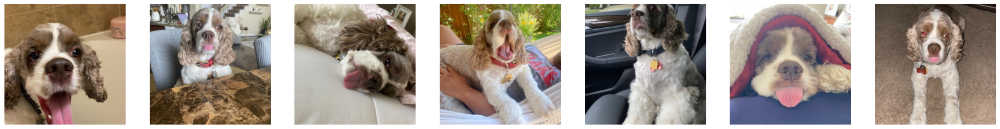

In [110]:
fig, ax = plt.subplots(1, len(Dog_Crop()), figsize=(len(Dog_Crop())*4,4))
for a, img in zip(ax, Dog_Crop.fetch('cropped_image')):
    a.imshow(img)
    a.axis(False)

In [111]:
@schema
class Dog_Style(dj.Lookup):
    definition = """
    style_name      : varchar(30)
    """
    contents = (['udnie'], ['la_muse'], ['starry_night'], ['mosaic'],
                ['candy'],['composition_vii'],['feathers'],['the_scream'], ['the_wave'])

In [117]:
@schema
class Dog_Transfer(dj.Computed):
    definition = """
    
    -> Dog_Image
    -> Dog_Style
    ---
    art_image : longblob
    """
    
    def make(self, key):
        image = (Dog_Image & key).fetch1('image')
        style_name = (Dog_Style & key).fetch1('style_name')
        net = cv2.dnn.readNetFromTorch(f'/home/ubuntu/StyleTransfer/notebooks/models/{style_name}.t7')
        image = imutils.resize(image, width=800)
        (h, w) = image.shape[:2]

        # construct a blob from the image, set the input, and then perform a
        # forward pass of the network
        blob = cv2.dnn.blobFromImage(image, 1.0, (w, h),
                                     (103.939, 116.779, 123.680), swapRB=False, crop=False)
        net.setInput(blob)
        output = net.forward()

        # reshape the output tensor, add back in the mean subtraction, and
        # then swap the channel ordering
        output = output.reshape((3, output.shape[2], output.shape[3]))
        output[0] += 103.939
        output[1] += 116.779
        output[2] += 123.680
        output = output.transpose(1, 2, 0)
        output = np.clip(output, 0, 255)
        output= output.astype('uint8')
        self.insert1(dict(key, art_image=output))

In [113]:
Dog_Image.drop()

`trasfer`.`_dog__image` (7 tuples)
`trasfer`.`__dog__transfer` (0 tuples)
`trasfer`.`__dog__crop` (7 tuples)
Proceed? [yes, No]: yes
Tables dropped.  Restart kernel.


In [118]:
Dog_Transfer.populate(display_progress=True)

Dog_Transfer: 100%|██████████| 63/63 [03:39<00:00,  3.48s/it]


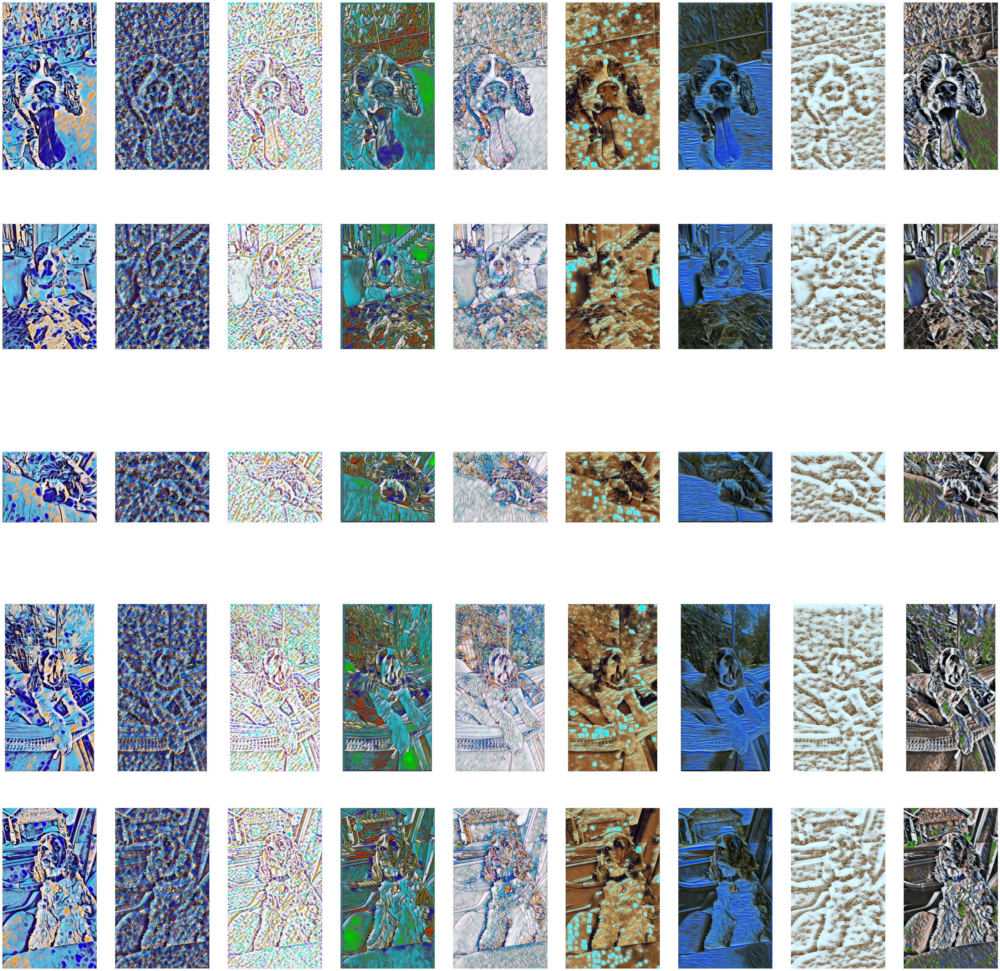

In [119]:
fig, axx = plt.subplots(5, 9, figsize=(50, 50))

for ax, img in zip(axx.flatten(), Dog_Transfer.fetch('art_image')):
    ax.imshow(img)
    ax.axis(False)